In [1]:
import string
import nltk
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from nltk.corpus import stopwords
import os
import plotly
import cufflinks as cf

In [2]:
os.getcwd()

'C:\\Users\\ASUS\\Downloads'

In [3]:
cf.go_offline()

In [4]:
df=pd.read_csv("C://Users//ASUS//Downloads//Grocery_and_Gourmet_Food.csv",low_memory=False,index_col=0)

C:\Users\ASUS\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:583: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



In [5]:
df.shape

(5074160, 12)

In [6]:
df.tail(5)

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,vote,image,style
5074155,5.0,True,"10 4, 2018",AGOPF2VTEOP57,B01HJHSVG6,Bob,"Love this product, very fresh, complete full f...",Exceclent product,1538611200,NaN,NaN,{'Size:': ' 2.29 oz'}
5074156,3.0,True,"10 3, 2018",A5X5TI4JCH9CN,B01HJHSVG6,Jacqueline Schafer,Good taste but small quantity for the expensiv...,Good taste but small quantity for the price us...,1538524800,NaN,NaN,{'Size:': ' 2.29 oz'}
5074157,4.0,True,"10 2, 2018",A1WMQQLC3TVAFI,B01HJHSVG6,Motionjunkie,Unlike some of the bad reviews regarding aroma...,See Comments below,1538438400,NaN,NaN,{'Size:': ' 2.29 oz'}
5074158,5.0,True,"09 30, 2018",ALVP6JZRTEDY6,B01HJHSVG6,Marissa,I absolutely love this vanilla bean paste. I h...,Love!!,1538265600,NaN,NaN,{'Size:': ' 2.29 oz'}
5074159,5.0,True,"09 29, 2018",AZFPVUZOVGBYR,B01HJHSVG6,Amazon Customer,So delicious!,Worth it,1538179200,NaN,NaN,{'Size:': ' 2.29 oz'}


In [7]:
df.head(5)

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,vote,image,style
0,5.0,True,"06 4, 2013",ALP49FBWT4I7V,1888861614,Lori,Very pleased with my purchase. Looks exactly l...,Love it,1370304000,NaN,NaN,NaN
1,4.0,True,"05 23, 2014",A1KPIZOCLB9FZ8,1888861614,BK Shopper,Very nicely crafted but too small. Am going to...,Nice but small,1400803200,NaN,NaN,NaN
2,4.0,True,"05 9, 2014",A2W0FA06IYAYQE,1888861614,daninethequeen,still very pretty and well made...i am super p...,"the ""s"" looks like a 5, kina",1399593600,NaN,NaN,NaN
3,5.0,True,"04 20, 2014",A2PTZTCH2QUYBC,1888861614,Tammara,"I got this for our wedding cake, and it was ev...",Would recommend this to a friend!,1397952000,NaN,NaN,NaN
4,4.0,True,"04 16, 2014",A2VNHGJ59N4Z90,1888861614,LaQuinta Alexander,It was just what I want to put at the top of m...,Topper,1397606400,NaN,NaN,NaN


In [8]:
df.describe()

,overall,unixReviewTime
count,5.074160e+06,5.074160e+06
mean,4.314708e+00,1.446592e+09
std,1.249303e+00,6.227839e+07
min,1.000000e+00,9.613728e+08
25%,4.000000e+00,1.416096e+09
50%,5.000000e+00,1.456790e+09
75%,5.000000e+00,1.491782e+09
max,5.000000e+00,1.538870e+09


In [9]:
df.corr()

,overall,verified,unixReviewTime
overall,1.000000,0.077329,-0.008704
verified,0.077329,1.000000,0.172134
unixReviewTime,-0.008704,0.172134,1.000000


In [10]:
# cols=list(df.columns)

df=df.drop(columns=['reviewTime','reviewerID','asin','unixReviewTime','vote','image','style'],axis=1)

# df=df.drop(columns=['Unnamed: 0'],axis=1)

df

,overall,verified,reviewerName,reviewText,summary
0,5.0,True,Lori,Very pleased with my purchase. Looks exactly l...,Love it
1,4.0,True,BK Shopper,Very nicely crafted but too small. Am going to...,Nice but small
2,4.0,True,daninethequeen,still very pretty and well made...i am super p...,"the ""s"" looks like a 5, kina"
3,5.0,True,Tammara,"I got this for our wedding cake, and it was ev...",Would recommend this to a friend!
4,4.0,True,LaQuinta Alexander,It was just what I want to put at the top of m...,Topper
...,...,...,...,...,...
5074155,5.0,True,Bob,"Love this product, very fresh, complete full f...",Exceclent product
5074156,3.0,True,Jacqueline Schafer,Good taste but small quantity for the expensiv...,Good taste but small quantity for the price us...
5074157,4.0,True,Motionjunkie,Unlike some of the bad reviews regarding aroma...,See Comments below
5074158,5.0,True,Marissa,I absolutely love this vanilla bean paste. I h...,Love!!


In [11]:
df[['overall','verified','reviewerName','reviewText','summary']].isnull()

,overall,verified,reviewerName,reviewText,summary
0,False,False,False,False,False
1,False,False,False,False,False
2,False,False,False,False,False
3,False,False,False,False,False
4,False,False,False,False,False
...,...,...,...,...,...
5074155,False,False,False,False,False
5074156,False,False,False,False,False
5074157,False,False,False,False,False
5074158,False,False,False,False,False


In [12]:
list(np.where(pd.isnull(df)))

[array([   2598,    3975,    4120, ..., 5072861, 5073196, 5073698],
       dtype=int64),
 array([3, 3, 3, ..., 3, 3, 3], dtype=int64)]

In [13]:
df.iloc[2598,3]

nan

In [14]:
df.dropna(inplace = True)

In [15]:
df.duplicated()


0          False
1          False
2          False
3          False
4          False
           ...  
5074155    False
5074156    False
5074157    False
5074158    False
5074159    False
Length: 5069416, dtype: bool

In [16]:
list(np.where(df.duplicated()))

[array([    173,    1728,    1735, ..., 5069384, 5069386, 5069404],
       dtype=int64)]

In [17]:
df.drop_duplicates(inplace = True)

In [18]:
df.shape

(4643144, 5)

In [19]:
df.head()

,overall,verified,reviewerName,reviewText,summary
0,5.0,True,Lori,Very pleased with my purchase. Looks exactly l...,Love it
1,4.0,True,BK Shopper,Very nicely crafted but too small. Am going to...,Nice but small
2,4.0,True,daninethequeen,still very pretty and well made...i am super p...,"the ""s"" looks like a 5, kina"
3,5.0,True,Tammara,"I got this for our wedding cake, and it was ev...",Would recommend this to a friend!
4,4.0,True,LaQuinta Alexander,It was just what I want to put at the top of m...,Topper


In [20]:
list(np.where(df['overall']>=3.5))

[array([      0,       1,       2, ..., 4643141, 4643142, 4643143],
       dtype=int64)]

In [21]:
# if (np.where(df['overall']>=3.5)):
#     df['sentiment']="positive"
# elif(np.where(df['overall']<3.5)):
#     df['sentiment']="negative"

# df['sentiment'] = np.where(df['overall'] ==5, "positive",
#                            np.where(df['overall'] == 3, "neutral",np.where(df['overall'] ==1,"negative")))
def map_sentiment(overall_rating):
    if overall_rating == 5:
        return "positive"
    elif overall_rating == 3:
        return "neutral"
    elif overall_rating == 1:
        return "negative"
    else:
        return None  

df['sentiment'] = df['overall'].apply(map_sentiment)

df = df.dropna(subset=['sentiment'])

print(df)

         overall  verified        reviewerName  \
0            5.0      True                Lori   
3            5.0      True             Tammara   
5            1.0      True       Brianna Small   
6            5.0      True     trinette claude   
7            3.0      True            Rela1982   
...          ...       ...                 ...   
5074154      5.0      True                  GB   
5074155      5.0      True                 Bob   
5074156      3.0      True  Jacqueline Schafer   
5074158      5.0      True             Marissa   
5074159      5.0      True     Amazon Customer   

                                                reviewText  \
0        Very pleased with my purchase. Looks exactly l...   
3        I got this for our wedding cake, and it was ev...   
5        The S is beautiful, however upon checkout it i...   
6        Omg.. The S was inexpensive and EXACTLY what w...   
7        It was a nice size for a cake topper and it wa...   
...                        

In [22]:
np.where(df['sentiment'].isnull())

(array([], dtype=int64),)

In [23]:
df['sentiment'].value_counts()

positive    3242536
negative     382895
neutral      301645
Name: sentiment, dtype: int64

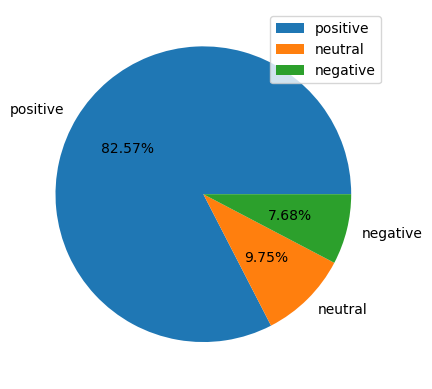

In [24]:
pie=np.array(df['sentiment'].value_counts())
plt.title='sentiment'
lebels=['positive','neutral','negative']
# autopct='%1.1f%%'
plt.pie(pie,labels=lebels,autopct='%1.2f%%')
plt.legend()
plt.show()

In [25]:
negative=(df['sentiment']=='negative').value_counts()
positive=(df['sentiment']=='positive').value_counts()
neutral=(df['sentiment']=='neutral').value_counts()
print("negative=",negative)
print("positive=",positive)
print("neutral=",neutral)

negative= False    3544181
True      382895
Name: sentiment, dtype: int64
positive= True     3242536
False     684540
Name: sentiment, dtype: int64
neutral= False    3625431
True      301645
Name: sentiment, dtype: int64


In [26]:
(df['overall']==2).value_counts()

False    3927076
Name: overall, dtype: int64

In [27]:
df.head(2)

,overall,verified,reviewerName,reviewText,summary,sentiment
0,5.0,True,Lori,Very pleased with my purchase. Looks exactly l...,Love it,positive
3,5.0,True,Tammara,"I got this for our wedding cake, and it was ev...",Would recommend this to a friend!,positive


In [28]:
df['verified'].value_counts()

True     3436330
False     490746
Name: verified, dtype: int64

In [29]:
df = df.drop(df[df['verified'] == False].index)

In [30]:
df.shape

(3436330, 6)

In [31]:
df['sentiment'].value_counts()

positive    2869749
negative     303985
neutral      262596
Name: sentiment, dtype: int64

In [32]:
df = df.drop(df[(df['sentiment'] == 'positive') & (df.index >= 1) & (df.index <= 4609000)].index)

In [33]:
df = df.drop(df[(df['sentiment'] == 'negative') & (df.index >= 1) & (df.index <= 1000000)].index)

In [34]:
df['sentiment'].value_counts()

negative    263050
positive    262742
neutral     262596
Name: sentiment, dtype: int64

In [35]:
df.shape

(788388, 6)

In [36]:
df.head()

,overall,verified,reviewerName,reviewText,summary,sentiment
0,5.0,True,Lori,Very pleased with my purchase. Looks exactly l...,Love it,positive
7,3.0,True,Rela1982,It was a nice size for a cake topper and it wa...,Great Buy.,neutral
40,3.0,True,3-Time-Dad,Same product and name as the tea I've bought a...,Not All Yellow Label Is The Same...,neutral
60,3.0,True,Amazon Customer,"Normally this tea rates 5 stars, it has a wond...",A Bad Batch,neutral
68,3.0,True,N D,I have recently started drinking hot tea again...,Not Bad for iced Tea,neutral


In [37]:
df.drop(['overall','verified','reviewerName','summary'],axis=1,inplace=True)

In [38]:
df.head()

,reviewText,sentiment
0,Very pleased with my purchase. Looks exactly l...,positive
7,It was a nice size for a cake topper and it wa...,neutral
40,Same product and name as the tea I've bought a...,neutral
60,"Normally this tea rates 5 stars, it has a wond...",neutral
68,I have recently started drinking hot tea again...,neutral


In [39]:
df.iloc[1]['reviewText']

'It was a nice size for a cake topper and it was very sparkley. I will purchase more products in the future from this source.'

In [40]:
df['text_length']=df['reviewText'].apply(len)

In [41]:
sns.set_style('white')

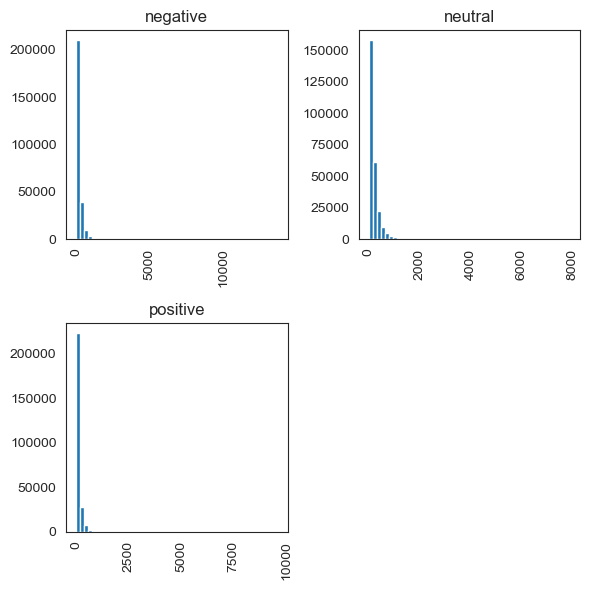

In [42]:
df.hist(column='text_length',by='sentiment',bins=50,figsize=(6,6))
plt.tight_layout()

In [43]:
df.iplot(kind='hist',bins=10,column=['sentiment','text_length'])

<AxesSubplot:xlabel='sentiment', ylabel='count'>

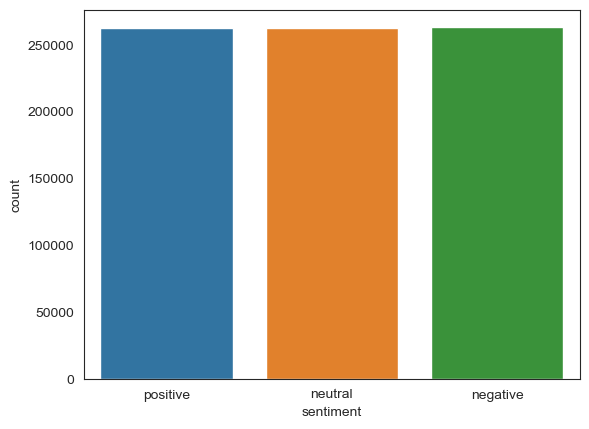

In [44]:
sns.countplot(data=df,x='sentiment')

In [59]:
def text_process(mess):
    """
    1. remove punc 
    
    2. remove stopwords
    
    3. return list of clean words
    """
    nopunc= [char for char in mess if char not in string.punctuation]
    
    nopunc=''.join(nopunc)
    
    words= [word for word in nopunc.split() if word.lower() not in stopwords.words('english')]
    trigrams = [words[i:i + 3] for i in range(len(words) - 2)]
    return [' '.join(trigram) for trigram in trigrams]

In [60]:
df['reviewText'].apply(text_process)

0          [pleased purchase Looks, purchase Looks exactl...
7          [nice size cake, size cake topper, cake topper...
40         [product name tea, name tea Ive, tea Ive bough...
60         [Normally tea rates, tea rates 5, rates 5 star...
68         [recently started drinking, started drinking h...
                                 ...                        
5074154    [Youll never go, never go back, go back plain,...
5074155    [Love product fresh, product fresh complete, f...
5074156    [Good taste small, taste small quantity, small...
5074158    [absolutely love vanilla, love vanilla bean, v...
5074159                                                   []
Name: reviewText, Length: 788388, dtype: object

In [61]:
df['reviewText'].head(5).apply(text_process)

0     [pleased purchase Looks, purchase Looks exactl...
7     [nice size cake, size cake topper, cake topper...
40    [product name tea, name tea Ive, tea Ive bough...
60    [Normally tea rates, tea rates 5, rates 5 star...
68    [recently started drinking, started drinking h...
Name: reviewText, dtype: object

In [62]:
from sklearn.feature_extraction.text import CountVectorizer

In [63]:
bow_transformer=CountVectorizer(analyzer=text_process,ngram_range=(3, 3)).fit(df['reviewText'])

C:\Users\ASUS\anaconda3\lib\site-packages\sklearn\feature_extraction\text.py:498: UserWarning:

The parameter 'ngram_range' will not be used since 'analyzer' is callable'



In [64]:
print(len(bow_transformer.vocabulary_))

8907962


In [66]:
mess10=df['reviewText'][5074154]

In [67]:
mess10

"You'll never go back to plain ol' Vanilla Extract after enjoying this superb culinary delight."

In [68]:
bow10=bow_transformer.transform([mess10])

In [69]:
print(bow10)

  (0, 485179)	1
  (0, 1202001)	1
  (0, 1257671)	1
  (0, 1614748)	1
  (0, 3319975)	1
  (0, 4038171)	1
  (0, 5583070)	1
  (0, 5732832)	1
  (0, 6198121)	1
  (0, 7692778)	1


In [70]:
bow_transformer.get_feature_names()[224455]

'Amazon going website'

In [71]:
messages_bow=bow_transformer.transform(df['reviewText'])

In [72]:
print(messages_bow.shape)

(788388, 8907962)


In [73]:
messages_bow.nnz

10665658

In [74]:
from sklearn.feature_extraction.text import TfidfTransformer

In [75]:
tfidf_transformer=TfidfTransformer().fit(messages_bow)

In [76]:
tfidf10=tfidf_transformer.transform(bow10)

In [77]:
print(tfidf10)

  (0, 7692778)	0.3307798494239132
  (0, 6198121)	0.3307798494239132
  (0, 5732832)	0.3307798494239132
  (0, 5583070)	0.2342521250504909
  (0, 4038171)	0.2977534569291291
  (0, 3319975)	0.3307798494239132
  (0, 1614748)	0.3307798494239132
  (0, 1257671)	0.300934642907286
  (0, 1202001)	0.3307798494239132
  (0, 485179)	0.3307798494239132


In [79]:
tfidf_transformer.idf_[bow_transformer.vocabulary_['university going website']]

KeyError: 'university going website'

In [80]:
messages_tfidf=tfidf_transformer.transform(messages_bow)

In [81]:
from sklearn.naive_bayes import MultinomialNB

In [ ]:
model=MultinomialNB().fit(messages_tfidf,df['sentiment'])

In [ ]:
predictions=model.predict(messages_tfidf)

In [ ]:
predictions

In [82]:
from sklearn.model_selection import train_test_split

In [83]:
msg_train,msg_test,sentiment_train,sentiment_test=train_test_split(df['reviewText'],df['sentiment'],test_size=0.3)

In [84]:
from sklearn.pipeline import Pipeline

In [ ]:
from sklearn.linear_model import LogisticRegression

In [85]:
pipeline=Pipeline([
    ('bow',CountVectorizer(analyzer=text_process,ngram_range=(3, 3))),
    ('tfidf',TfidfTransformer()),
    ('classifier',MultinomialNB())
])

In [86]:
pipeline.fit(msg_train,sentiment_train)

Pipeline(steps=[('bow',
                 CountVectorizer(analyzer=<function text_process at 0x0000018A0E271670>,
                                 ngram_range=(3, 3))),
                ('tfidf', TfidfTransformer()),
                ('classifier', MultinomialNB())])

In [87]:
predict=pipeline.predict(msg_test)

In [89]:
from sklearn.metrics import classification_report,confusion_matrix

In [90]:
print(classification_report(sentiment_test,predict))
print('\n')
print(confusion_matrix(sentiment_test,predict))

              precision    recall  f1-score   support

    negative       0.46      0.79      0.58     79041
     neutral       0.62      0.44      0.52     78590
    positive       0.73      0.40      0.52     78886

    accuracy                           0.55    236517
   macro avg       0.60      0.55      0.54    236517
weighted avg       0.60      0.55      0.54    236517



[[62486 12756  3799]
 [35649 34958  7983]
 [38864  8314 31708]]


In [88]:
from joblib import dump

dump(pipeline,'sentiment_analysis_naive_9.12_73_new.joblib')

['sentiment_analysis_naive_9.12_73_new.joblib']

In [89]:
from joblib import load

# Load the model from a file

loaded_model = load('sentiment_analysis_naive_9.12_73_new.joblib')

In [91]:
pred=loaded_model.predict(messages_tfidf)

ValueError: Iterable over raw text documents expected, string object received.

In [69]:
df

,reviewText,sentiment,text_length
0,Very pleased with my purchase. Looks exactly l...,positive,121
5,"The S is beautiful, however upon checkout it i...",negative,176
22,Tasted old and not individually bag,negative,35
27,Not the great taste everyone was talking about :(,negative,49
37,Terrible. What a waste of money. This is not t...,negative,73
...,...,...,...
5074155,"Love this product, very fresh, complete full f...",positive,67
5074156,Good taste but small quantity for the expensiv...,neutral,137
5074157,Unlike some of the bad reviews regarding aroma...,positive,720
5074158,I absolutely love this vanilla bean paste. I h...,positive,442


In [58]:
(df['reviewText'][5074154])

"You'll never go back to plain ol' Vanilla Extract after enjoying this superb culinary delight."